In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
from sklearn.model_selection import train_test_split
import seaborn as sns
import json

In [2]:
# pip install pandas numpy matplotlib scikit-learn seaborn

## Data preprocessing

### Original dataset with garden_door and hallway_door

In [3]:
# Load and preprocess door and window data
garden_door_df = pd.read_csv('datasets/Door_windows.csv')
garden_door_df = garden_door_df.drop('Door_balcony_1st_floor', axis=1)
garden_door_df = garden_door_df.drop('Door_Hallway', axis=1)
garden_door_df['Date'] = pd.to_datetime(garden_door_df['Date'], format='%d/%m/%Y %H:%M')
garden_door_df['Door_Garden'] = garden_door_df['Door_Garden'].map({'on': 1, 'off': 0})
garden_door_df = garden_door_df.drop_duplicates(subset='Date', keep='last')

# RESAMPLANJE U 1 SEKUNDU
garden_door_df.set_index('Date', inplace=True)
garden_door_df = garden_door_df.resample('1s').ffill()
garden_door_df.reset_index(inplace=True)
garden_door_df = garden_door_df.drop('Unnamed: 0', axis=1)
#garden_door_df.to_csv("datasets/garden_door_dataset.csv", index=False)

# Load and preprocess door and window data
hallway_door_df = pd.read_csv('datasets/Door_windows.csv')
hallway_door_df = hallway_door_df.drop('Door_balcony_1st_floor', axis=1)
hallway_door_df = hallway_door_df.drop('Door_Garden', axis=1)
hallway_door_df['Date'] = pd.to_datetime(hallway_door_df['Date'], format='%d/%m/%Y %H:%M')
hallway_door_df['Door_Hallway'] = hallway_door_df['Door_Hallway'].map({'on': 1, 'off': 0})
hallway_door_df = hallway_door_df.drop_duplicates(subset='Date', keep='last')

# RESAMPLANJE U 1 SEKUNDU
hallway_door_df.set_index('Date', inplace=True)
hallway_door_df = hallway_door_df.resample('1s').ffill()
hallway_door_df.reset_index(inplace=True)
hallway_door_df = hallway_door_df.drop('Unnamed: 0', axis=1)
#garden_door_df.to_csv("datasets/garden_door_dataset.csv", index=False)

sensor_df = pd.read_csv('datasets/LS0623020168.csv')
# Convert UTC to UTC+2
sensor_df['timestamp(ZG)'] = pd.to_datetime(sensor_df['timestamp(UTC)']) + timedelta(hours=2)

# Handling daylight savings ZG: (UTC+2) -> (UTC+1)
dst_cutoff = pd.Timestamp('2024-10-27 03:00:00')
sensor_df['timestamp(ZG)'] = sensor_df['timestamp(ZG)'].apply(
    lambda x: x - timedelta(hours=1) if x >= dst_cutoff else x
)

merged_df = pd.merge(sensor_df, garden_door_df[["Date", "Door_Garden"]],
                     left_on="timestamp(ZG)", right_on="Date", how="left")
merged_df = pd.merge(merged_df, hallway_door_df[["Date", "Door_Hallway"]],
                     left_on="timestamp(ZG)", right_on="Date", how="left")
merged_df = merged_df.drop(columns=["Date_x", "Date_y"])
merged_df = merged_df[merged_df["timestamp(ZG)"] >= garden_door_df['Date'].min()]

# Dropping duplicated values of timestamp resulted in moving the clock by 1 hour
merged_df = merged_df.drop_duplicates(subset='timestamp(ZG)', keep='first')
merged_df = merged_df.dropna()

#merged_df.to_csv("datasets/merged_sensor_data.csv", index=False)

### Motion dataset

In [4]:
motion_df = pd.read_csv('datasets/Motion.csv')
motion_df = motion_df.drop('Unnamed: 0', axis=1)
motion_df['Timestamp'] = pd.to_datetime(motion_df['Timestamp'], format='%Y-%m-%d %H:%M:%S')
motion_df = motion_df.set_index('Timestamp').resample('1s').ffill().reset_index()
# Merge motion detection data with primary dataset based on timestamps
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    motion_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})
#merged_df.to_csv("datasets/merged_sensor_data_with_motion.csv", index=False)

### People dataset

In [5]:
people_df = pd.read_csv('datasets/People.csv')
people_df = people_df.drop('Unnamed: 0', axis=1)
people_df.rename(columns={'People in a room' : 'people_in_room'}, inplace= True)
people_df['Timestamp'] = pd.to_datetime(people_df['Timestamp'], format='%Y-%m-%d %H:%M:%S')
people_df = people_df.set_index('Timestamp').resample('1s').ffill().reset_index()
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    people_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})

In [6]:
# Fill missing values in 'motion_detection' based on 'people_in_room'
merged_df['Motion_detection'] = merged_df['Motion_detection'].fillna(
    merged_df['people_in_room'].apply(lambda x: 0 if x == 0 else 1)
)

### Outdoor sensor dataset

In [7]:
outdoor_sensor_df = pd.read_csv('datasets\Outdoor_sensor_provider_2.csv')
outdoor_sensor_df = outdoor_sensor_df.drop('Unnamed: 0', axis=1)
outdoor_sensor_df['Timestamp'] = pd.to_datetime(outdoor_sensor_df['Timestamp'], format='%Y-%m-%d %H:%M:%S')
outdoor_sensor_df = outdoor_sensor_df.dropna()
# Removing duplicates due to rollback of clock, keeping the first, the same as in the indoor sensor data, so they match
outdoor_sensor_df = outdoor_sensor_df.drop_duplicates(subset='Timestamp', keep='first')
# Resampling the data to 1 second intervals, using linear approximation to fill missing values
outdoor_sensor_df = outdoor_sensor_df.set_index('Timestamp').resample('1s').interpolate(method='linear').reset_index()
outdoor_sensor_df = outdoor_sensor_df.rename(columns=lambda x: "outdoor_" + x)
merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    outdoor_sensor_df.rename(columns={'outdoor_Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})


### Adding experiment column 

In [8]:
with open("datasets/experiments.json", "r") as file:
    experiment_data = json.load(file)

start_time = merged_df['timestamp(ZG)'].min()
end_time = merged_df['timestamp(ZG)'].max()

all_timestamps = pd.date_range(start=start_time, end=end_time, freq="1s")
experiment_df = pd.DataFrame({"Timestamp": all_timestamps, "experiment": 0})

for ranges in experiment_data["experiments"].values():
    for start, end in ranges:
        start, end = pd.to_datetime(start), pd.to_datetime(end)
        experiment_df.loc[(experiment_df['Timestamp'] >= start) & (experiment_df['Timestamp'] <= end), 'experiment'] = 1

merged_df = pd.merge_asof(
    merged_df.rename(columns={'timestamp(ZG)': 'timestamp'}).sort_values('timestamp'), 
    experiment_df.rename(columns={'Timestamp': 'timestamp'}).sort_values('timestamp'), 
    on='timestamp',
    direction='backward'
).rename(columns={'timestamp': 'timestamp(ZG)'})

#merged_df.to_csv("datasets/merged_sensor_data_with_motion_experiments.csv", index=False)

### Filtering out times of experiments being done (except door_opened)

In [9]:
"""with open("datasets/experiments.json", "r") as file:
    experiment_data = json.load(file)

# Convert the experiment intervals into a DataFrame
intervals = []
for experiment, times in experiment_data["experiments"].items():
    for time_range in times:
        intervals.append({"start": pd.to_datetime(time_range[0]), "end": pd.to_datetime(time_range[1])})
intervals = intervals[1:]   # OSTAVLJAMO DOOR OPENING
intervals_df = pd.DataFrame(intervals)

# Filter out rows within the intervals
for _, row in intervals_df.iterrows():
    merged_df = merged_df[
        ~((merged_df['timestamp(ZG)'] >= row['start']) & (merged_df['timestamp(ZG)'] <= row['end']))
    ]
    
merged_df = merged_df.dropna()
#merged_df.to_csv("datasets/merged_sensor_data_no_experiments.csv", index=False)"""

'with open("datasets/experiments.json", "r") as file:\n    experiment_data = json.load(file)\n\n# Convert the experiment intervals into a DataFrame\nintervals = []\nfor experiment, times in experiment_data["experiments"].items():\n    for time_range in times:\n        intervals.append({"start": pd.to_datetime(time_range[0]), "end": pd.to_datetime(time_range[1])})\nintervals = intervals[1:]   # OSTAVLJAMO DOOR OPENING\nintervals_df = pd.DataFrame(intervals)\n\n# Filter out rows within the intervals\nfor _, row in intervals_df.iterrows():\n    merged_df = merged_df[\n        ~((merged_df[\'timestamp(ZG)\'] >= row[\'start\']) & (merged_df[\'timestamp(ZG)\'] <= row[\'end\']))\n    ]\n    \nmerged_df = merged_df.dropna()\n#merged_df.to_csv("datasets/merged_sensor_data_no_experiments.csv", index=False)'

### Filtering out (removing) when hallway doors are opened by themselves

In [10]:
"""merged_df = merged_df[~((merged_df['Door_Hallway'] == 1) & (merged_df['Door_Garden'] == 0))]"""

"merged_df = merged_df[~((merged_df['Door_Hallway'] == 1) & (merged_df['Door_Garden'] == 0))]"

## LET'S TRY REMOVING ALL THE LABELED DATA, UNLESS THE DOOR IS OPENED AT THAT TIME

In [11]:
# Calculate the original number of rows
original_row_count = merged_df.shape[0]
door_garden_count = (merged_df['Door_Garden'] == 1).sum()

# Define the columns to check
columns_to_check = ['Door_Hallway', 'Motion_detection', 'people_in_room', 'experiment']

# Apply the filtering condition
merged_df = merged_df[
    ~((merged_df[columns_to_check].any(axis=1)) & (merged_df['Door_Garden'] == 0))
]

# Calculate the number of rows remaining after filtering
remaining_row_count = merged_df.shape[0]

# Calculate the number of rows deleted
rows_deleted = original_row_count - remaining_row_count

# Calculate the percentage of rows deleted
percentage_deleted = (rows_deleted / original_row_count) * 100

door_garden_count2 = (merged_df['Door_Garden'] == 1).sum()

# Print the results
print(f"Original number of rows: {original_row_count}")
print(f"Number of rows deleted: {rows_deleted}")
print(f"Percentage of rows deleted: {percentage_deleted:.2f}%")
#print(f"Before number of door_garden rows: {door_garden_count}, after number of door_garden rows: {door_garden_count2}")


Original number of rows: 313916
Number of rows deleted: 15502
Percentage of rows deleted: 4.94%


## Visualizing the data

In [12]:
# Visualizing the whole dataset
"""
# Set up a figure for the subplots
fig, axs = plt.subplots(8, 2, figsize=(15, 30))
fig.suptitle('Time series of paramaters', fontsize=16)

# List of parameters and titles
parameters = [
    ('NetCO2-CO2(ppm)', 'NetCO2-CO2 (ppm)'),
    ('NetCO2-CO2_ug', 'NetCO2-CO2 (µg)'),
    ('NetADC_O3-O3_ug', 'NetADC_O3-O3 (µg)'),
    ('NetADC_O3-O3(ppb)', 'NetADC_O3-O3 (ppb)'),
    ('NetADC_CO-CO_ug', 'NetADC_CO-CO (µg)'),
    ('NetADC_CO-CO( ppb)', 'NetADC_CO-CO (ppb)'),
    ('NetPM-PM10(µg/m3)', 'NetPM-PM10 (µg/m³)'),
    ('NetPM-PM25(µg/m3)', 'NetPM-PM25 (µg/m³)'),
    ('NetPid_P1-PPB(ppm)', 'NetPid_P1-PPB (ppm)'),
    ('NetPid_P1-PPB_ug', 'NetPid_P1-PPB (µg)'),
    ('NetBME280-PERC(%)', 'NetBME280 Humidity (%)'),
    ('NetBME280-TEMP_EXT(°C)', 'NetBME280 Temperature (°C)'),
    ('NetBME280-HPA(hPa)', 'NetBME280 Pressure (hPa)'),
    ('NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2 (µg)'),
    ('NetADC_NO2-NO2(ppb)', 'NetADC_NO2-NO2 (ppb)')
]

# Plot each parameter in a separate subplot
for i, (param, title) in enumerate(parameters):
    row, col = divmod(i, 2)
    axs[row, col].plot(sensor_df['timestamp(ZG)'], sensor_df[param])
    axs[row, col].set_title(title)
    axs[row, col].set_xlabel('Time')
    axs[row, col].set_ylabel(title)
    axs[row, col].tick_params(axis='x', rotation=45)

axs[7,1].plot(merged_df['timestamp(ZG)'],merged_df['any_door_open'])
axs[7,1].set_title('Any door open')
axs[7,1].set_xlabel('Time')
axs[7,1].set_ylabel('Yes (1), No (0)')
axs[7,1].tick_params(axis='x', rotation=45)

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to fit title
plt.show()
"""

"\n# Set up a figure for the subplots\nfig, axs = plt.subplots(8, 2, figsize=(15, 30))\nfig.suptitle('Time series of paramaters', fontsize=16)\n\n# List of parameters and titles\nparameters = [\n    ('NetCO2-CO2(ppm)', 'NetCO2-CO2 (ppm)'),\n    ('NetCO2-CO2_ug', 'NetCO2-CO2 (µg)'),\n    ('NetADC_O3-O3_ug', 'NetADC_O3-O3 (µg)'),\n    ('NetADC_O3-O3(ppb)', 'NetADC_O3-O3 (ppb)'),\n    ('NetADC_CO-CO_ug', 'NetADC_CO-CO (µg)'),\n    ('NetADC_CO-CO( ppb)', 'NetADC_CO-CO (ppb)'),\n    ('NetPM-PM10(µg/m3)', 'NetPM-PM10 (µg/m³)'),\n    ('NetPM-PM25(µg/m3)', 'NetPM-PM25 (µg/m³)'),\n    ('NetPid_P1-PPB(ppm)', 'NetPid_P1-PPB (ppm)'),\n    ('NetPid_P1-PPB_ug', 'NetPid_P1-PPB (µg)'),\n    ('NetBME280-PERC(%)', 'NetBME280 Humidity (%)'),\n    ('NetBME280-TEMP_EXT(°C)', 'NetBME280 Temperature (°C)'),\n    ('NetBME280-HPA(hPa)', 'NetBME280 Pressure (hPa)'),\n    ('NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2 (µg)'),\n    ('NetADC_NO2-NO2(ppb)', 'NetADC_NO2-NO2 (ppb)')\n]\n\n# Plot each parameter in a separate s

For visualizing door opening, the data is reduced from 5s to 1m readings, the sensor data is the average value in that 1 minute, each day is saved as image in daily_plots

In [13]:
"""# Generating images by days
import os

parameters = [
    #('NetCO2-CO2(ppm)', 'NetCO2-CO2 (ppm)'),
    ('NetCO2-CO2_ug', 'NetCO2-CO2 (µg)'),
    ('NetADC_O3-O3_ug', 'NetADC_O3-O3 (µg)'),
    #('NetADC_O3-O3(ppb)', 'NetADC_O3-O3 (ppb)'),
    ('NetADC_CO-CO_ug', 'NetADC_CO-CO (µg)'),
    #('NetADC_CO-CO( ppb)', 'NetADC_CO-CO (ppb)'),
    ('NetPM-PM10(µg/m3)', 'NetPM-PM10 (µg/m³)'),
    ('NetPM-PM25(µg/m3)', 'NetPM-PM25 (µg/m³)'),
    #('NetPid_P1-PPB(ppm)', 'NetPid_P1-PPB (ppm)'),
    ('NetPid_P1-PPB_ug', 'NetPid_P1-PPB (µg)'),
    ('NetBME280-PERC(%)', 'NetBME280 Humidity (%)'),
    ('NetBME280-TEMP_EXT(°C)', 'NetBME280 Temperature (°C)'),
    ('NetBME280-HPA(hPa)', 'NetBME280 Pressure (hPa)'),
    ('NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2 (µg)'),
    ('NetADC_NO2-NO2(ppb)', 'NetADC_NO2-NO2 (ppb)'),
    ('Door_Hallway', 'Door_Hallway'),
    ('Motion_detection', 'Motion_detection'),
    ('people_in_room', 'people_in_room')
]

merged_df = merged_df.drop('timestamp(UTC)', axis=1)

# Set the UTC+1 timestamp as the index
merged_df.set_index('timestamp(ZG)', inplace=True)

# Resample the data to 1-minute intervals and calculate the mean
data_resampled = merged_df.resample('1min').mean()

# Reset the index to make 'timestamp(ZG)' a column again
data_resampled = data_resampled.reset_index()

# Ensure the directory for saving plots exists
output_dir = "model_training_data_all_labeled_data_removed_except_when_garden_door_1"
os.makedirs(output_dir, exist_ok=True)

# Loop through each unique day in the dataset
data_resampled['date'] = data_resampled['timestamp(ZG)'].dt.date
unique_days = data_resampled['date'].unique()

for day in unique_days:
    # Filter data for the specific day
    day_data = data_resampled[data_resampled['date'] == day]
    open_door_times = day_data[day_data['Door_Garden'] == 1]['timestamp(ZG)']
    experiment_times = day_data[day_data['experiment'] == 1]['timestamp(ZG)']
    
    # Set up a figure for the subplots
    fig, axs = plt.subplots(8, 2, figsize=(15, 22))
    fig.suptitle(
        f'Time series of parameters for {day}, red line = garden door open, darker red line = door opened and experiment being done', 
        fontsize=16
    )
    
    # Plot each parameter in a separate subplot
    for i, (param, title) in enumerate(parameters):
        row, col = divmod(i, 2)
        axs[row, col].plot(day_data['timestamp(ZG)'], day_data[param])
        axs[row, col].set_title(title)
        axs[row, col].set_xlabel('Time')
        axs[row, col].set_ylabel(title)
        axs[row, col].tick_params(axis='x', rotation=45)
        
        # Add vertical lines for door open times with color
        for open_time in open_door_times:
            open_time_door_data = day_data[day_data['timestamp(ZG)'] == open_time]
            if (open_time_door_data['Door_Garden'].values == 1):
                axs[row, col].axvline(x=open_time, color='red', lw=1, alpha=0.2)
        
        for experiment_time in experiment_times:
            experiment_times_data = day_data[day_data['timestamp(ZG)'] == experiment_time]
            if (experiment_times_data['experiment'].values == 1):
                axs[row, col].axvline(x=experiment_time, color='black', lw=1, alpha=0.05)
    
    # Remove unused subplots if they exist
    for j in range(len(parameters), len(axs.flatten())):
        fig.delaxes(axs.flatten()[j])
    
    # Adjust layout and save the plot
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to fit title
    plt.savefig(os.path.join(output_dir, f'{day}.png'))
    plt.close(fig)
    """

'# Generating images by days\nimport os\n\nparameters = [\n    #(\'NetCO2-CO2(ppm)\', \'NetCO2-CO2 (ppm)\'),\n    (\'NetCO2-CO2_ug\', \'NetCO2-CO2 (µg)\'),\n    (\'NetADC_O3-O3_ug\', \'NetADC_O3-O3 (µg)\'),\n    #(\'NetADC_O3-O3(ppb)\', \'NetADC_O3-O3 (ppb)\'),\n    (\'NetADC_CO-CO_ug\', \'NetADC_CO-CO (µg)\'),\n    #(\'NetADC_CO-CO( ppb)\', \'NetADC_CO-CO (ppb)\'),\n    (\'NetPM-PM10(µg/m3)\', \'NetPM-PM10 (µg/m³)\'),\n    (\'NetPM-PM25(µg/m3)\', \'NetPM-PM25 (µg/m³)\'),\n    #(\'NetPid_P1-PPB(ppm)\', \'NetPid_P1-PPB (ppm)\'),\n    (\'NetPid_P1-PPB_ug\', \'NetPid_P1-PPB (µg)\'),\n    (\'NetBME280-PERC(%)\', \'NetBME280 Humidity (%)\'),\n    (\'NetBME280-TEMP_EXT(°C)\', \'NetBME280 Temperature (°C)\'),\n    (\'NetBME280-HPA(hPa)\', \'NetBME280 Pressure (hPa)\'),\n    (\'NetADC_NO2-NO2_ug\', \'NetADC_NO2-NO2 (µg)\'),\n    (\'NetADC_NO2-NO2(ppb)\', \'NetADC_NO2-NO2 (ppb)\'),\n    (\'Door_Hallway\', \'Door_Hallway\'),\n    (\'Motion_detection\', \'Motion_detection\'),\n    (\'people_in_ro

In [14]:
"""import os
import math
import pandas as pd
import matplotlib.pyplot as plt

# dropping as it's not a numeric column
merged_df = merged_df.drop('timestamp(UTC)', axis=1)

# -------------------------
# 2. Resample Data to 1-Minute Averages
# -------------------------
# Set 'timestamp(ZG)' as the index, resample to 1-minute frequency, and then reset the index.
merged_df.set_index('timestamp(ZG)', inplace=True)
df_resampled = merged_df.resample('1min').mean().reset_index()

# Create a new column holding just the date (for grouping later)
df_resampled['date'] = df_resampled['timestamp(ZG)'].dt.date

# -------------------------
# 3. Define Indoor/Outdoor Parameter Pairs
# -------------------------
# Each tuple contains:
#   (indoor column name, outdoor column name, common label for the parameter)
parameter_pairs = [
    ('NetBME280-TEMP_EXT(°C)', 'outdoor_temperature(C)', 'Temperature (°C)'),
    ('NetBME280-PERC(%)', 'outdoor_relativeHumidity(%)', 'Humidity (%)'),
    ('NetBME280-HPA(hPa)', 'outdoor_pressure(µg/m³)', 'Pressure'),
    ('NetADC_O3-O3_ug', 'outdoor_O3(µg/m³)', 'O₃ (µg/m³)'),
    ('NetADC_CO-CO_ug', 'outdoor_CO(mg/m³)', 'CO'),
    ('NetADC_NO2-NO2_ug', 'outdoor_NO2(µg/m³)', 'NO₂ (µg/m³)'),
    ('NetCO2-CO2_ug', 'outdoor_CO2(mg/m³)', 'CO₂'),
    ('NetPM-PM10(µg/m3)', 'outdoor_PM10(µg/m³)', 'PM10 (µg/m³)'),
    ('NetPM-PM25(µg/m3)', 'outdoor_PM2P5(µg/m³)', 'PM2.5 (µg/m³)')
]

# -------------------------
# 4. Create Output Folder for Daily Plots
# -------------------------
output_dir = "daily_indoor_outdoor_plots"
os.makedirs(output_dir, exist_ok=True)

# -------------------------
# 5. Loop Through Each Day and Plot
# -------------------------
# Get the list of unique days
unique_days = df_resampled['date'].unique()

for day in unique_days:
    # Subset data for the current day
    day_data = df_resampled[df_resampled['date'] == day]
    
    # If you wish to mark events like door openings, extract the times.
    # (This example uses 'Door_Garden' if it exists.)
    door_open_times = []
    if 'Door_Garden' in day_data.columns:
        door_open_times = day_data[day_data['Door_Garden'] == 1]['timestamp(ZG)']
    
    # (If you have an 'experiment' column, you can extract those times similarly.)
    experiment_times = []
    if 'experiment' in day_data.columns:
        experiment_times = day_data[day_data['experiment'] == 1]['timestamp(ZG)']
    
    # Determine the grid size for subplots.
    n_pairs = len(parameter_pairs)
    ncols = 3  # e.g. three columns of subplots
    nrows = math.ceil(n_pairs / ncols)
    
    fig, axs = plt.subplots(nrows, ncols, figsize=(5 * ncols, 4 * nrows), sharex=True)
    axs = axs.flatten()  # Flatten to simplify iteration
    
    # Loop over each indoor/outdoor parameter pair and plot on the same axis.
    for i, (indoor_col, outdoor_col, label) in enumerate(parameter_pairs):
        ax = axs[i]
        # Plot indoor parameter in blue
        ax.plot(day_data['timestamp(ZG)'], day_data[indoor_col], label=f'Indoor {label}', color='blue')
        # Plot outdoor parameter in green
        ax.plot(day_data['timestamp(ZG)'], day_data[outdoor_col], label=f'Outdoor {label}', color='green')
        ax.set_title(label)
        ax.set_xlabel('Time')
        ax.set_ylabel(label)
        ax.tick_params(axis='x', rotation=45)
        
        # Optionally add vertical lines where the door was opened.
        for open_time in door_open_times:
            ax.axvline(x=open_time, color='red', lw=1, alpha=0.2)
        
        # Optionally add vertical lines for experiment times.
        for exp_time in experiment_times:
            ax.axvline(x=exp_time, color='black', lw=1, alpha=0.05)
        
        ax.legend()
    
    # Remove any unused subplots
    for j in range(i + 1, len(axs)):
        fig.delaxes(axs[j])
    
    # Add a super-title and adjust layout.
    fig.suptitle(f'Indoor vs. Outdoor Air Parameters for {day}', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    
    # Save the figure for the current day
    output_path = os.path.join(output_dir, f'{day}.png')
    plt.savefig(output_path)
    plt.close(fig)
"""

'import os\nimport math\nimport pandas as pd\nimport matplotlib.pyplot as plt\n\n# dropping as it\'s not a numeric column\nmerged_df = merged_df.drop(\'timestamp(UTC)\', axis=1)\n\n# -------------------------\n# 2. Resample Data to 1-Minute Averages\n# -------------------------\n# Set \'timestamp(ZG)\' as the index, resample to 1-minute frequency, and then reset the index.\nmerged_df.set_index(\'timestamp(ZG)\', inplace=True)\ndf_resampled = merged_df.resample(\'1min\').mean().reset_index()\n\n# Create a new column holding just the date (for grouping later)\ndf_resampled[\'date\'] = df_resampled[\'timestamp(ZG)\'].dt.date\n\n# -------------------------\n# 3. Define Indoor/Outdoor Parameter Pairs\n# -------------------------\n# Each tuple contains:\n#   (indoor column name, outdoor column name, common label for the parameter)\nparameter_pairs = [\n    (\'NetBME280-TEMP_EXT(°C)\', \'outdoor_temperature(C)\', \'Temperature (°C)\'),\n    (\'NetBME280-PERC(%)\', \'outdoor_relativeHumidity(%

## Data normalization

In [15]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

parameters_to_normalize = [
    'NetCO2-CO2(ppm)', 'NetCO2-CO2_ug', 'NetADC_O3-O3_ug',
    'NetADC_O3-O3(ppb)', 'NetADC_CO-CO_ug', 'NetADC_CO-CO( ppb)',
    'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB(ppm)',
    'NetPid_P1-PPB_ug', 'NetBME280-PERC(%)', 'NetBME280-TEMP_EXT(°C)',
    'NetBME280-HPA(hPa)', 'NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2(ppb)'
]

# parameters_to_normalize = [
#     'NetCO2-CO2(ppm)', 'NetCO2-CO2_ug', 'NetADC_O3-O3_ug',
#     'NetADC_O3-O3(ppb)', 'NetADC_CO-CO_ug', 'NetADC_CO-CO( ppb)',
#     'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB(ppm)',
#     'NetPid_P1-PPB_ug', 'NetBME280-PERC(%)', 'NetBME280-TEMP_EXT(°C)',
#     'NetBME280-HPA(hPa)', 'NetADC_NO2-NO2_ug', 'NetADC_NO2-NO2(ppb)',
#     'outdoor_NO2(µg/m³)', 'outdoor_NO(µg/m³)',
#     'outdoor_O3(µg/m³)', 'outdoor_CO2(mg/m³)', 'outdoor_CO(mg/m³)',
#     'outdoor_H2S(µg/m³)', 'outdoor_PM1(µg/m³)', 'outdoor_PM2P5(µg/m³)',
#     'outdoor_PM10(µg/m³)', 'outdoor_VOC(mg/m³)', 'outdoor_temperature(C)',
#     'outdoor_relativeHumidity(%)', 'outdoor_pressure(µg/m³)',
#     'outdoor_windDirection(degrees)', 'outdoor_windSpeed(m/s)',
#     'outdoor_gust(m/s)'
# ]

#scaler = MinMaxScaler()  # Use StandardScaler() for Z-score normalization
scaler = StandardScaler()
sensor_df_normalized = merged_df.copy()
sensor_df_normalized[parameters_to_normalize] = scaler.fit_transform(merged_df[parameters_to_normalize])

In [16]:
"""data_to_plot = sensor_df_normalized[parameters_to_normalize]

plt.figure(figsize=(15, 8))  # Set the figure size
sns.boxplot(data=data_to_plot, orient='v', palette='coolwarm')

plt.title('Distribucija normaliziranih parametara senzora', fontsize=16)  # Plot title in Croatian
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.xlabel('Parametri senzora', fontsize=12)
plt.ylabel('Vrijednosti (normalizirane)', fontsize=12)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()"""

"data_to_plot = sensor_df_normalized[parameters_to_normalize]\n\nplt.figure(figsize=(15, 8))  # Set the figure size\nsns.boxplot(data=data_to_plot, orient='v', palette='coolwarm')\n\nplt.title('Distribucija normaliziranih parametara senzora', fontsize=16)  # Plot title in Croatian\nplt.xticks(rotation=90)  # Rotate x-axis labels for better readability\nplt.xlabel('Parametri senzora', fontsize=12)\nplt.ylabel('Vrijednosti (normalizirane)', fontsize=12)\n\nplt.tight_layout()  # Adjust layout to prevent overlap\nplt.show()"

Correlation matrix with normalized data is the same as the corr. matrix with un-normalized data

# MODELS


In [17]:
from sklearn.metrics import confusion_matrix, classification_report, matthews_corrcoef
from sklearn.metrics import ConfusionMatrixDisplay

def evaluate_model(y_pred, y_test, name):
    cm = confusion_matrix(y_test, y_pred)
    mcc = matthews_corrcoef(y_test, y_pred)
    print("="*50)
    print(f"Results for {name}:")
    print(f"MCC: {mcc:.4f}")
    print("Classification Report:\n", classification_report(y_test, y_pred))
    print("Confusion Matrix:\n")
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
    disp.plot(cmap=plt.cm.Blues)
    plt.title(f"Confusion Matrix for {name}")
    plt.show()
    print("="*50)

# GRU

In [18]:
# izbaciti PCA, izbaciti SVE OSIM OCITANJA, od ocitanja izbaciti: temp, pressure, humidty, outdoor

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import matthews_corrcoef
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Define your features and target.
features = ['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
            'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
            'NetADC_NO2-NO2_ug']

# Assume sensor_df_normalized and merged_df are already defined.
X = sensor_df_normalized[features].values
y = merged_df[['Door_Garden']].values

# Split data (using a simple train/test split).
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Reshape data for GRU input (samples, timesteps, features).
# Here we use a single timestep.
X_train = X_train.reshape(X_train.shape[0], 1, X_train.shape[1])
X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])

# Build the GRU model.
model = Sequential([
    GRU(16, activation='tanh', return_sequences=False, 
        input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.2),
    Dense(8, activation='relu'),
    Dropout(0.2),
    Dense(1, activation='sigmoid')  # For binary classification
])

# Compile the model.
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Define early stopping.
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model.
history = model.fit(
    X_train, y_train,
    validation_data=(X_test, y_test),
    epochs=30,
    batch_size=32,
    verbose=1,
    callbacks=[early_stopping]
)

# Predict probabilities on the test set.
y_pred_prob = model.predict(X_test)

Epoch 1/30


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


7461/7461 ━━━━━━━━━━━━━━━━━━━━ 14s 2ms/step - accuracy: 0.9675 - loss: 0.1247 - val_accuracy: 0.9736 - val_loss: 0.0764
Epoch 2/30
7461/7461 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.9824 - loss: 0.0537 - val_accuracy: 0.9689 - val_loss: 0.0821
Epoch 3/30
7461/7461 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9837 - loss: 0.0505 - val_accuracy: 0.9710 - val_loss: 0.0748
Epoch 4/30
7461/7461 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9841 - loss: 0.0490 - val_accuracy: 0.9738 - val_loss: 0.0727
Epoch 5/30
7461/7461 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9840 - loss: 0.0494 - val_accuracy: 0.9712 - val_loss: 0.0763
Epoch 6/30
7461/7461 ━━━━━━━━━━━━━━━━━━━━ 11s 1ms/step - accuracy: 0.9844 - loss: 0.0485 - val_accuracy: 0.9696 - val_loss: 0.0835
Epoch 7/30
7461/7461 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9850 - loss: 0.0466 - val_accuracy: 0.9702 - val_loss: 0.0811
Epoch 8/30
7461/7461 ━━━━━━━━━━━━━━━━━━━━ 11s 2ms/step - accuracy: 0.9849 - loss: 0.0467 - val

Best MCC: 0.8054 at Threshold: 0.04399999999999998
Results for GRU v2:
MCC: 0.8054
Classification Report:
               precision    recall  f1-score   support

         0.0       0.99      0.99      0.99     57715
         1.0       0.79      0.83      0.81      1968

    accuracy                           0.99     59683
   macro avg       0.89      0.91      0.90     59683
weighted avg       0.99      0.99      0.99     59683

Confusion Matrix:



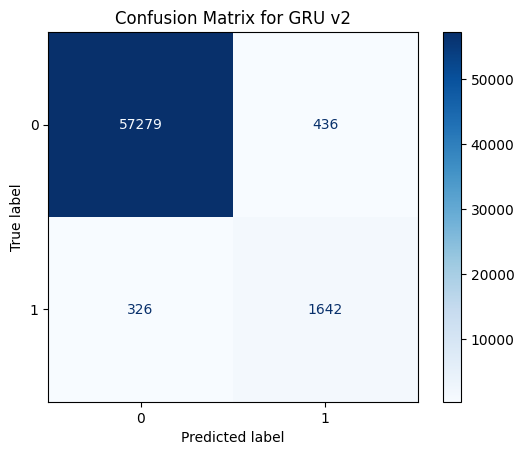

In [20]:
# ORIGINAL (REMOVED HALLWAY_DOOR, EXPERIMENTS, even if garden_door = 1)
# 0.1  = MCC 0.504, experiments removed
# 0.1 = MCC 0.57, experiments, door_hallway removed
# 0.00338 = MCC 0.7784, experiments, door_hallway removed

# ADDED HALLWAY_DOOR, PEOPLE, MOTION, EXPERIMENTS
# 0.02743 = MCC 0.7148

# REMOVED HALLWAY_DOOR, PEOPLE, MOTION, EXPERIMENTS (unless garden_door = 1)
# 0.003422 = MCC 0.8225

# REMOVED HALLWAY_DOOR, PEOPLE, MOTION, EXPERIMENTS (unless garden_door = 1), ****FIX
# 0.018 = MCC 0.9418

# REMOVED HALLWAY_DOOR, ACTUALLY ADDED PEOPLE, MOTION, EXPERIMENTS, OUTDOOR (unless garden_door = 1) 
# 0.480 = MCC 0.7896
 
best_mcc = -1  # MCC ranges from -1 to 1
best_threshold = 0

for threshold in np.arange(0.01, 0.7, 0.001):
    # Binarize the predictions based on the threshold
    y_pred = (y_pred_prob > threshold).astype(int)
    
    mcc = matthews_corrcoef(y_test, y_pred)
    if mcc > best_mcc:
        best_mcc = mcc
        best_threshold = threshold

y_pred_class = (y_pred_prob > best_threshold).astype(int)

print(f"Best MCC: {best_mcc:.4f} at Threshold: {best_threshold}")
evaluate_model(y_pred_class, y_test, "GRU v2")

## Visualization of the test set

In [21]:
"""import plotly.graph_objects as go
import pandas as pd

test_size = 0.2
split_idx = int(len(merged_df) * (1 - test_size))

test_times = merged_df["timestamp(ZG)"].iloc[split_idx:].reset_index(drop=True)
train_times = merged_df["timestamp(ZG)"].iloc[:split_idx].reset_index(drop=True)

y_test_flat = y_test.flatten()
y_pred_flat = y_pred_class.flatten()

# Create a DataFrame for plotting
df = pd.DataFrame({
    'timestamp': test_times,      # your test_times series
    'Actual': y_test_flat,        # your flattened actual values
    'Predicted': y_pred_flat      # your flattened predicted values
})

# Create the interactive plot
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=df['timestamp'],
    y=df['Actual'],
    mode='lines',
    name='Actual Door_Garden'
))
fig.add_trace(go.Scatter(
    x=df['timestamp'],
    y=df['Predicted'],
    mode='lines',
    name='Predicted Door_Garden',
    line=dict(dash='dot')
))

fig.update_layout(
    title='Actual vs Predicted Door_Garden on Test Set',
    xaxis_title='Time',
    yaxis_title='Door_Garden Value',
    width=1400,   # Increase the width of the plot
    height=700,   # Increase the height of the plot
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1d", step="day", stepmode="backward"),
                dict(count=3, label="3d", step="day", stepmode="backward"),
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    )
)

fig.show()"""

'import plotly.graph_objects as go\nimport pandas as pd\n\ntest_size = 0.2\nsplit_idx = int(len(merged_df) * (1 - test_size))\n\ntest_times = merged_df["timestamp(ZG)"].iloc[split_idx:].reset_index(drop=True)\ntrain_times = merged_df["timestamp(ZG)"].iloc[:split_idx].reset_index(drop=True)\n\ny_test_flat = y_test.flatten()\ny_pred_flat = y_pred_class.flatten()\n\n# Create a DataFrame for plotting\ndf = pd.DataFrame({\n    \'timestamp\': test_times,      # your test_times series\n    \'Actual\': y_test_flat,        # your flattened actual values\n    \'Predicted\': y_pred_flat      # your flattened predicted values\n})\n\n# Create the interactive plot\nfig = go.Figure()\n\nfig.add_trace(go.Scatter(\n    x=df[\'timestamp\'],\n    y=df[\'Actual\'],\n    mode=\'lines\',\n    name=\'Actual Door_Garden\'\n))\nfig.add_trace(go.Scatter(\n    x=df[\'timestamp\'],\n    y=df[\'Predicted\'],\n    mode=\'lines\',\n    name=\'Predicted Door_Garden\',\n    line=dict(dash=\'dot\')\n))\n\nfig.update_la

# SHAP Explainability

In [22]:
import shap
shap.initjs()

In [27]:
import shap
import numpy as np

# Define a wrapper that reshapes 2D inputs (samples, features) into 3D (samples, timesteps, features) for your GRU model.
def model_predict_wrapper(x):
    # Reshape input from (samples, features) to (samples, 1, features)
    x_reshaped = x.reshape(x.shape[0], 1, x.shape[1])
    return model.predict(x_reshaped)

# Prepare a background dataset for KernelExplainer.
# Convert the 3D training data (X_train) into 2D by taking the feature dimension,
# then select a contiguous block of 100 samples.
background_kernel = X_train.reshape(X_train.shape[0], X_train.shape[2])[:100]

# Create the KernelExplainer using the wrapper and the background data.
explainer_kernel = shap.KernelExplainer(model_predict_wrapper, background_kernel)

# Reshape X_test from 3D to 2D for SHAP analysis.
X_test_2d = X_test.reshape(X_test.shape[0], X_test.shape[2])
print(X_test.shape)

# Instead of random sampling, select the first 100 samples to preserve temporal structure.
X_test_subset = X_test_2d[:100]

# Compute SHAP values with a reduced nsamples value (e.g., 50) for faster computation.
shap_values_kernel = explainer_kernel.shap_values(X_test_subset, nsamples=1000)

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


  0%|          | 0/100 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 987us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 982us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 955us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 984us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 984us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 954us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 939us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
394/394 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


In [ ]:
# Define the feature names matching your sensor columns as a NumPy array
feature_names = np.array([
    'NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
    'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug',
    'NetADC_NO2-NO2_ug'
])
# Generate a SHAP summary plot to visualize feature impact.
#shap.summary_plot(shap_values_kernel, X_test_subset, feature_names)

In [ ]:
# ---------------------------
# 1. Force Plot for a Single Sample
# ---------------------------
# Choose a sample index (e.g., the first sample)
sample_index = 0
force_plot = shap.force_plot(explainer_kernel.expected_value, 
                               shap_values_kernel[sample_index, :], 
                               X_test_subset[sample_index, :], 
                               feature_names=feature_names)
# In Jupyter, simply having force_plot as the last line will display it:
force_plot

In [ ]:
# ---------------------------
# 2. Dependence Plot for a Specific Feature
# ---------------------------
# Here we create a dependence plot for the first feature (index 0).
# You can change the index to any feature of interest.
shap.dependence_plot(0, shap_values_kernel, X_test_subset, feature_names=feature_names)

In [ ]:
# ---------------------------
# 3. Decision Plot for the Entire Subset
# ---------------------------
# This plot shows how the model's output accumulates from the base value.
shap.decision_plot(explainer_kernel.expected_value, shap_values_kernel, 
                   X_test_subset, feature_names=feature_names)

# Permutation Importance

In [ ]:
# Function to determine the best threshold based on MCC.
def best_mcc_threshold(y_true, y_pred_prob):
    best_mcc = -1  # MCC ranges from -1 to 1
    best_threshold = 0
    for threshold in np.arange(0.01, 0.99, 0.01):
        y_pred = (y_pred_prob > threshold).astype(int)
        mcc = matthews_corrcoef(y_true, y_pred)
        if mcc > best_mcc:
            best_mcc = mcc
            best_threshold = threshold
    return best_mcc, best_threshold

# Evaluate baseline performance.
baseline_mcc, baseline_threshold = best_mcc_threshold(y_test, y_pred_prob)
print(f"Baseline MCC: {baseline_mcc:.4f} at Threshold: {baseline_threshold}")

# Compute permutation importance using MCC.
results = []
results.append({'feature': 'BASELINE', 'mcc': baseline_mcc})

# Save a copy of the original test data.
X_test_original = X_test.copy()

# For each feature, permute its values and compute the new MCC.
for i in tqdm(range(X_test.shape[2]), desc="Computing permutation importance"):
    X_test_permuted = X_test_original.copy()
    # Shuffle the i-th feature column.
    np.random.shuffle(X_test_permuted[:, 0, i])
    
    # Get predictions with the permuted feature.
    y_pred_perm_prob = model.predict(X_test_permuted)
    
    # Compute the best MCC for the permuted data.
    perm_mcc, perm_threshold = best_mcc_threshold(y_test, y_pred_perm_prob)
    results.append({'feature': features[i], 'mcc': perm_mcc})

# Create a DataFrame with the results.
df_results = pd.DataFrame(results)
df_results = df_results.sort_values(by='mcc', ascending=False)
# Optionally, save the results to CSV.
df_results.to_csv('gru_permutation_importance_mcc.csv', index=False)


Computing permutation importance:   0%|          | 0/7 [00:00<?, ?it/s]

1866/1866 ━━━━━━━━━━━━━━━━━━━━ 2s 968us/step


Computing permutation importance:  14%|█▍        | 1/7 [00:04<00:24,  4.09s/it]

1866/1866 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


Computing permutation importance:  29%|██▊       | 2/7 [00:08<00:20,  4.09s/it]

1866/1866 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


Computing permutation importance:  43%|████▎     | 3/7 [00:12<00:16,  4.18s/it]

1866/1866 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


Computing permutation importance:  57%|█████▋    | 4/7 [00:16<00:12,  4.13s/it]

1866/1866 ━━━━━━━━━━━━━━━━━━━━ 2s 998us/step


Computing permutation importance:  71%|███████▏  | 5/7 [00:20<00:08,  4.05s/it]

1866/1866 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


Computing permutation importance:  86%|████████▌ | 6/7 [00:24<00:04,  4.02s/it]

1866/1866 ━━━━━━━━━━━━━━━━━━━━ 2s 978us/step


Computing permutation importance: 100%|██████████| 7/7 [00:28<00:00,  4.04s/it]


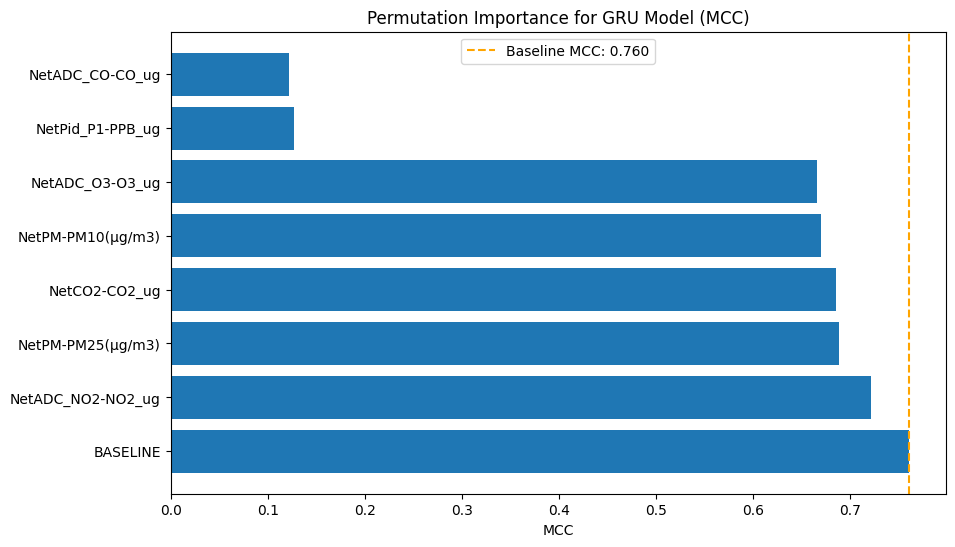

In [ ]:

# Plot the permutation importance.
plt.figure(figsize=(10, 6))
plt.barh(df_results['feature'], df_results['mcc'])
plt.xlabel('MCC')
plt.title('Permutation Importance for GRU Model (MCC)')
plt.axvline(baseline_mcc, color='orange', linestyle='--', 
            label=f'Baseline MCC: {baseline_mcc:.3f}')
plt.legend()
plt.show()

# GRU WITH CROSS-VALIDATION 

In [39]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import matthews_corrcoef
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Ensure the timestamp column is in datetime format
merged_df["timestamp(ZG)"] = pd.to_datetime(merged_df["timestamp(ZG)"])

# Prepare containers for aggregated predictions and ground truth
all_y_test = []
all_y_pred = []
best_mccs = []

# Define TimeSeriesSplit (e.g., 5 folds)
tscv = TimeSeriesSplit(n_splits=5)
fold = 1

X = sensor_df_normalized[['NetCO2-CO2_ug', 'NetADC_O3-O3_ug', 'NetADC_CO-CO_ug',
    'NetPM-PM10(µg/m3)', 'NetPM-PM25(µg/m3)', 'NetPid_P1-PPB_ug','NetADC_NO2-NO2_ug']].values
y = merged_df[['Door_Garden']].values


for train_index, test_index in tscv.split(X):
    print(f"\nFold {fold}")
    
    # Print the time interval for the test set of this fold
    start_time = merged_df["timestamp(ZG)"].iloc[test_index[0]]
    end_time = merged_df["timestamp(ZG)"].iloc[test_index[-1]]
    print(f"Time interval for fold {fold}: {start_time} to {end_time}")
    
    # Create training and test sets for current fold
    X_train_fold, X_test_fold = X[train_index], X[test_index]
    y_train_fold, y_test_fold = y[train_index], y[test_index]
    
    # Reshape for GRU input (samples, timesteps, features)
    X_train_fold = X_train_fold.reshape(X_train_fold.shape[0], 1, X_train_fold.shape[1])
    X_test_fold = X_test_fold.reshape(X_test_fold.shape[0], 1, X_test_fold.shape[1])
    
    # Define a new GRU model for this fold
    model = Sequential([
        GRU(16, activation='tanh', return_sequences=False, 
            input_shape=(X_train_fold.shape[1], X_train_fold.shape[2])),
        Dropout(0.2),
        Dense(8, activation='relu'),
        Dropout(0.2),
        Dense(1, activation='sigmoid')  # Binary classification
    ])
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    
    # Train the model on the current fold
    history = model.fit(
        X_train_fold, y_train_fold,
        validation_data=(X_test_fold, y_test_fold),
        epochs=30,
        batch_size=32,
        verbose=1,
        callbacks=[early_stopping]
    )
    
    # Predict probabilities on the test set of the current fold
    y_pred_prob_fold = model.predict(X_test_fold)
    
    # Find the best threshold for this fold using MCC
    best_mcc = -1
    best_threshold = 0
    for threshold in np.arange(0.01, 0.8, 0.001):
        y_pred_temp = (y_pred_prob_fold > threshold).astype(int)
        mcc = matthews_corrcoef(y_test_fold, y_pred_temp)
        if mcc > best_mcc:
            best_mcc = mcc
            best_threshold = threshold
    
    print(f"Fold {fold} - Best MCC: {best_mcc:.4f} at Threshold: {best_threshold:.4f}")
    
    # Apply the best threshold to obtain binary predictions for this fold
    y_pred_fold = (y_pred_prob_fold > best_threshold).astype(int)
    
    # Store the predictions and ground truth for later aggregation
    all_y_test.append(y_test_fold)
    all_y_pred.append(y_pred_fold)
    best_mccs.append(best_mcc)
    
    # --- Create Interactive Plot using Plotly for the current fold ---
    # Get the corresponding timestamps for the test set
    fold_timestamps = merged_df["timestamp(ZG)"].iloc[test_index].reset_index(drop=True)
    # Flatten the arrays in case they're 2D
    y_test_flat = y_test_fold.flatten()
    y_pred_flat = y_pred_fold.flatten()
    
    # Create a DataFrame for plotting
    df_plot = pd.DataFrame({
        'timestamp': fold_timestamps,
        'Actual': y_test_flat,
        'Predicted': y_pred_flat
    })
    
    # Create interactive Plotly figure
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Actual'],
        mode='lines',
        name='Actual Door_Garden'
    ))
    fig.add_trace(go.Scatter(
        x=df_plot['timestamp'],
        y=df_plot['Predicted'],
        mode='lines',
        name='Predicted Door_Garden',
        line=dict(dash='dot')
    ))
    
    fig.update_layout(
        title=f'Fold {fold} Actual vs Predicted Door_Garden',
        xaxis_title='Time',
        yaxis_title='Door_Garden Value',
        width=1400,   # Increase the width of the plot
        height=700,   # Increase the height of the plot
        xaxis=dict(
            rangeselector=dict(
                buttons=list([
                    dict(count=1, label="1d", step="day", stepmode="backward"),
                    dict(step="all")
                ])
            ),
            rangeslider=dict(visible=True),
            type="date"
        )
    )
    
    fig.show()
    # ---------------------------------------------------------
    
    fold += 1
# Concatenate the arrays from all folds
all_y_test = np.concatenate(all_y_test, axis=0)
all_y_pred = np.concatenate(all_y_pred, axis=0)



Fold 1
Time interval for fold 1: 2024-10-16 06:51:47 to 2024-10-19 05:05:44


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.8797 - loss: 0.3060 - val_accuracy: 0.9846 - val_loss: 0.1226
Epoch 2/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.9701 - loss: 0.1502 - val_accuracy: 0.9847 - val_loss: 0.0660
Epoch 3/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9713 - loss: 0.1231 - val_accuracy: 0.9863 - val_loss: 0.0443
Epoch 4/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9726 - loss: 0.1059 - val_accuracy: 0.9886 - val_loss: 0.0398
Epoch 5/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9741 - loss: 0.0984 - val_accuracy: 0.9894 - val_loss: 0.0401
Epoch 6/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9761 - loss: 0.0892 - val_accuracy: 0.9898 - val_loss: 0.0374
Epoch 7/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9748 - loss: 0.0878 - val_accuracy: 0.9894 - val_loss: 0.0394
Epoch 8/30
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - accuracy: 0.9790 - loss: 0.0805 - 


Fold 2
Time interval for fold 2: 2024-10-19 05:05:50 to 2024-10-22 08:40:01
Epoch 1/30


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



3109/3109 ━━━━━━━━━━━━━━━━━━━━ 12s 3ms/step - accuracy: 0.9660 - loss: 0.1709 - val_accuracy: 0.9787 - val_loss: 0.0578
Epoch 2/30
3109/3109 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9815 - loss: 0.0682 - val_accuracy: 0.9860 - val_loss: 0.0479
Epoch 3/30
3109/3109 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9822 - loss: 0.0638 - val_accuracy: 0.9853 - val_loss: 0.0458
Epoch 4/30
3109/3109 ━━━━━━━━━━━━━━━━━━━━ 8s 3ms/step - accuracy: 0.9838 - loss: 0.0570 - val_accuracy: 0.9852 - val_loss: 0.0476
Epoch 5/30
3109/3109 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.9844 - loss: 0.0539 - val_accuracy: 0.9821 - val_loss: 0.0534
Epoch 6/30
3109/3109 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9855 - loss: 0.0528 - val_accuracy: 0.9794 - val_loss: 0.0595
Epoch 7/30
3109/3109 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9856 - loss: 0.0501 - val_accuracy: 0.9784 - val_loss: 0.0637
Epoch 8/30
3109/3109 ━━━━━━━━━━━━━━━━━━━━ 8s 2ms/step - accuracy: 0.9850 - loss: 0.0520 - val_accura


Fold 3
Time interval for fold 3: 2024-10-22 08:40:06 to 2024-10-25 11:37:14


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
4663/4663 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9399 - loss: 0.2517 - val_accuracy: 0.9661 - val_loss: 0.1048
Epoch 2/30
4663/4663 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9823 - loss: 0.0672 - val_accuracy: 0.9661 - val_loss: 0.1242
Epoch 3/30
4663/4663 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9837 - loss: 0.0552 - val_accuracy: 0.9660 - val_loss: 0.1374
Epoch 4/30
4663/4663 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.9839 - loss: 0.0528 - val_accuracy: 0.9661 - val_loss: 0.1288
Epoch 5/30
4663/4663 ━━━━━━━━━━━━━━━━━━━━ 10s 2ms/step - accuracy: 0.9836 - loss: 0.0523 - val_accuracy: 0.9660 - val_loss: 0.1451
Epoch 6/30
4663/4663 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.9837 - loss: 0.0527 - val_accuracy: 0.9660 - val_loss: 0.1478
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Fold 3 - Best MCC: 0.8463 at Threshold: 0.0410



Fold 4
Time interval for fold 4: 2024-10-25 11:37:19 to 2024-10-28 09:11:15


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 15s 2ms/step - accuracy: 0.9341 - loss: 0.2148 - val_accuracy: 0.9974 - val_loss: 0.0174
Epoch 2/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9795 - loss: 0.0636 - val_accuracy: 0.9974 - val_loss: 0.0155
Epoch 3/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9803 - loss: 0.0590 - val_accuracy: 0.9974 - val_loss: 0.0153
Epoch 4/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9818 - loss: 0.0547 - val_accuracy: 0.9973 - val_loss: 0.0148
Epoch 5/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9816 - loss: 0.0549 - val_accuracy: 0.9974 - val_loss: 0.0145
Epoch 6/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9822 - loss: 0.0541 - val_accuracy: 0.9974 - val_loss: 0.0144
Epoch 7/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9820 - loss: 0.0540 - val_accuracy: 0.9974 - val_loss: 0.0146
Epoch 8/30
6217/6217 ━━━━━━━━━━━━━━━━━━━━ 21s 2ms/step - accuracy: 0.9826 - loss: 0


Fold 5
Time interval for fold 5: 2024-10-28 09:11:20 to 2024-10-31 11:22:12


C:\Users\tjura\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/30
7772/7772 ━━━━━━━━━━━━━━━━━━━━ 20s 2ms/step - accuracy: 0.9751 - loss: 0.1095 - val_accuracy: 0.9641 - val_loss: 0.0989
Epoch 2/30
7772/7772 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.9830 - loss: 0.0502 - val_accuracy: 0.9676 - val_loss: 0.0874
Epoch 3/30
7772/7772 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.9840 - loss: 0.0491 - val_accuracy: 0.9668 - val_loss: 0.0882
Epoch 4/30
7772/7772 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.9850 - loss: 0.0458 - val_accuracy: 0.9621 - val_loss: 0.1091
Epoch 5/30
7772/7772 ━━━━━━━━━━━━━━━━━━━━ 16s 2ms/step - accuracy: 0.9845 - loss: 0.0467 - val_accuracy: 0.9627 - val_loss: 0.1012
Epoch 6/30
7772/7772 ━━━━━━━━━━━━━━━━━━━━ 13s 2ms/step - accuracy: 0.9851 - loss: 0.0460 - val_accuracy: 0.9667 - val_loss: 0.0977
Epoch 7/30
7772/7772 ━━━━━━━━━━━━━━━━━━━━ 18s 1ms/step - accuracy: 0.9852 - loss: 0.0461 - val_accuracy: 0.9701 - val_loss: 0.0894
1555/1555 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
Fold 5 - Best MCC: 0.7619 at Threshold: 

List of best MCC's: [0.6559045428615258, 0.7999987894556015, 0.8462794112885574, 0.49669972853936256, 0.7618761095060916]
Results for GRU Cross-Validated:
MCC: 0.7793
Classification Report:
               precision    recall  f1-score   support

         0.0       1.00      0.99      0.99    242485
         1.0       0.76      0.81      0.78      6190

    accuracy                           0.99    248675
   macro avg       0.88      0.90      0.89    248675
weighted avg       0.99      0.99      0.99    248675

Confusion Matrix:



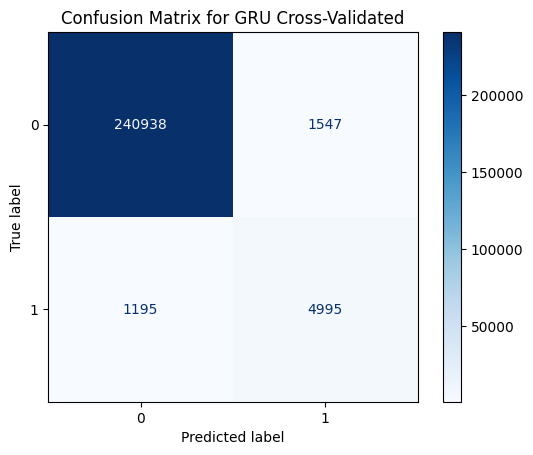

In [ ]:
# Use your evaluate_model function on the aggregated predictions
print(f"List of best MCC's: {best_mccs}")
evaluate_model(all_y_pred, all_y_test, "GRU Cross-Validated")

# indoor, hallway_opened, people, motion, experiment
# MCC: 0.8351 

# indoor
# List of best MCC's: [0.640705251662538, 0.8510591323547615, 0.3490898101714817, 0.0, 0.7286103452051088]
# MCC: 0.6003

# no pca, no temp, humidity, pressure
# List of best MCC's: [0.6559045428615258, 0.7999987894556015, 0.8462794112885574, 0.49669972853936256, 0.7618761095060916]
# MCC: 0.7793

In [ ]:
# todo: 
# explainability u gru - shap plot (dobijemo njavazniju), analzila najvaznije (permutation importance varijabla i plratimo importance)